In [38]:
import librosa
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import librosa.display
from sklearn.preprocessing import MinMaxScaler
import scipy, IPython.display as ipd
import librosa
import soundfile as sf

import pywt


plt.rcParams['figure.figsize'] = (14, 5)

# Load and preprocess audio 
**Label audio segments: Hammering Sound Detection** 

In [40]:
filename = 'Recording-total-hip-summarized'

y, sr = librosa.load(f'voice/{filename}.wav')

ipd.Audio(y, rate=sr)

In [41]:
segment_duration = 60
samples_per_segment = int(segment_duration * sr)

# Split the audio into segments
audio_segments = []
for i in range(0, len(y), samples_per_segment):
    l = len
    segment = y[i:i + samples_per_segment]
    segment = np.reshape(segment, (1,segment.size))
    audio_segments.append(segment)

In [ ]:
ipd.Audio(audio_segments[300], rate = sr)

In [ ]:
Selected_segments = [2,3,5,9,10,20,22,23,32,34]
temp = np.concatenate([audio_segments[i] for i in Selected_segments],axis= 1)
sf.write('voice/Recording-total-hip-summarized.wav', temp[0], sr)

In [ ]:
segment_duration = 2
# Calculate the number of samples per segment based on the duration
samples_per_segment = int(segment_duration * sr)

# Split the audio into segments
audio_segments = []
for i in range(0, len(y), samples_per_segment):
    l = len
    segment = y[i:i + samples_per_segment]
    segment = np.reshape(segment, (1,segment.size))
    audio_segments.append(segment)

In [ ]:
ipd.Audio(audio_segments[299], rate = sr)

In [ ]:
A = [1,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0]
B = [0,0,0,0,0,1,1,1,1,0,0,0,1,1,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0]
C = [0,0,0,0,0,0,0,0,1,1,1,1,1,0,0,0,1,1,0,0,0,1,0,0,0,0,0,0,0,0]
D = [0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0]
E = [0,0,0,0,0,0,0,0,0,1,1,1,1,1,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0]
F = [1,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,1,1,1,1,0,0,0,0,0,1,1,1,1,1]
G = [0,0,0,0,0,1,1,1,1,1,1,1,1,1,1,1,1,0,1,0,0,0,0,0,0,0,0,0,0,0]
H = [0,0,0,0,0,1,1,1,1,1,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0]
I = [1,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0]
J = [1,1,1,1,1,1,1,1,1,1,1,0,0,1,0,0,0,1,1,1,1,0,0,0,1,0,0,0,0,0]

In [ ]:
Labels = np.array(A + B + C + D + E+ F + G +H +I + J)
file_name = 'Recording-total-hip'
with open(f'Labels/{file_name}-summarized.npy', 'wb') as f:
    np.save(f, Labels)

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


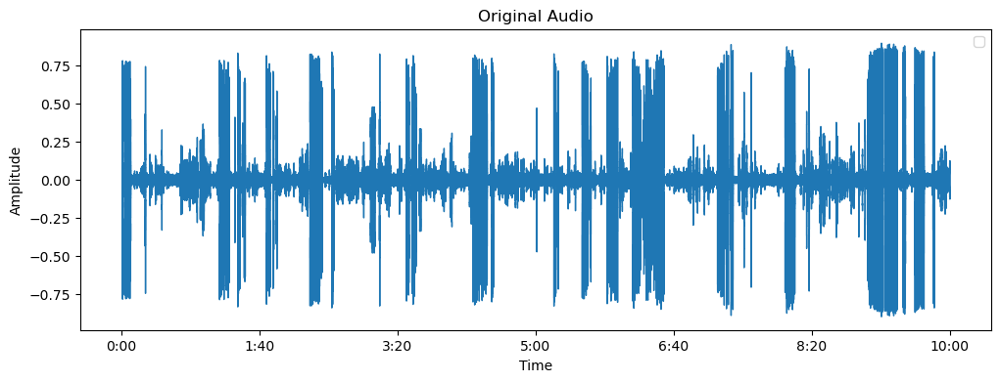

In [204]:
plt.figure(figsize=(12, 4))

filename = 'Recording-total-hip-summarized'

signal, sr = librosa.load(f'voice/{filename}.wav')

# voice/Recording-total-hip-summarized.wav
librosa.display.waveshow(signal, sr=sr, alpha=1)
plt.xlabel('Time')
plt.ylabel('Amplitude')
plt.title('Audio')
plt.legend()
plt.show()

# Feature Extraction

In [49]:
def normalize(x):
    scaler = MinMaxScaler()
    scaler.fit(x)
    return scaler.transform(x)

# Function to extract signal-based characteristics
def extract_characteristics(segment):
    spectral_centroid = np.mean(librosa.feature.spectral_centroid(y=segment, sr=sr)[0])
    spectral_rolloff = np.mean(librosa.feature.spectral_rolloff(y=segment, sr=sr)[0])
    zero_crossing_rate = np.mean(librosa.feature.zero_crossing_rate(segment)[0])
    rms_energy = np.mean(librosa.feature.rms(y=segment)[0])
    spectral_contrast = np.mean(librosa.feature.spectral_contrast(y=segment, sr=sr)[0])
    chroma = np.mean(librosa.feature.chroma_stft(y=segment, sr=sr))

    return spectral_centroid, spectral_rolloff, zero_crossing_rate, rms_energy, spectral_contrast, chroma

def extract_transforms(segment):
    # Discrete Fourier Transform (DFT)
    dft = np.abs(np.fft.fft(segment))
    return dft

def Audio_segmentation(audio):
    segment_duration = 2
    # Calculate the number of samples per segment based on the duration
    samples_per_segment = int(segment_duration * sr)

    # Split the audio into segments
    audio_segments = []
    for i in range(0, len(audio), samples_per_segment):
        l = len
        segment = audio[i:i + samples_per_segment]
        segment = np.reshape(segment, (1,segment.size))
        audio_segments.append(segment)
    return audio_segments

# Classification Models 
- Random Forest
- XGBOOST
- Logistic Regression
- SVM\
Input Features: signal-based characteristics or Discrete Fourier Transform (DFT)

In [192]:
import pandas as pd
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
import xgboost as xgb

In [193]:
def train_and_evaluate_classifier(classifier, X_train, X_test, y_train, y_test):
    
    classifier.fit(X_train, y_train)
    predictions = classifier.predict(X_test)
    
    accuracy = accuracy_score(y_test, predictions)
    precision = precision_score(y_test, predictions)
    recall = recall_score(y_test, predictions)
    f1 = f1_score(y_test, predictions)
    
    return np.round([accuracy,precision,recall,f1],3)

def Prediction_model(X_train, X_test, y_train, y_test):
    # Define classifiers
    random_forest = RandomForestClassifier(n_estimators=200, random_state=30)
    logistic_regression = LogisticRegression(random_state=0, penalty='l2', solver='lbfgs', max_iter=1000)
    support_vector_machine = SVC(kernel='rbf')
    XGboost = xgb.XGBClassifier()

    classifiers = {
        "Random Forest": random_forest,
        "Logistic Regression": logistic_regression,
        "Support Vector Machine": support_vector_machine,
        "XGBoost": XGboost
    }

    results = pd.DataFrame(columns=["Accuracy", "Precision", "Recall", "F1-Score"])

    # Evaluate each classifier and store results
    for clf_name, clf in classifiers.items():
        metrics = train_and_evaluate_classifier(clf, X_train, X_test, y_train, y_test)
        results.loc[clf_name,:] = metrics
    return results


- **Input Features: Discrete Fourier Transform (DFT)**

In [194]:
List_of_labeled_audios = ['Recording-total-hip-summarized','4-5783063126354170334_hJXjGp5D']
hammering_features = []
speech_features = []

for filename in List_of_labeled_audios:

    audio , sr = librosa.load(f'voice/{filename}.wav')
    with open(f'Labels/{filename}.npy', 'rb') as f:
        Label_of_sound = np.load(f)
    
    All_audio_segments = Audio_segmentation(audio)

    for  i in range(len(All_audio_segments)):
        segment = All_audio_segments[i]
        features = list(extract_transforms(segment).flatten())

        if Label_of_sound[i] == 1:

            hammering_features.append(features)
        else:
            speech_features.append(features)


max_length = max(len(feature) for feature in hammering_features + speech_features)

# Padding all features to have the same length
hammering_features_padded = [np.pad(feature, (0, max_length - len(feature))) for feature in hammering_features]
speech_features_padded = [np.pad(feature, (0, max_length - len(feature))) for feature in speech_features]

all_features = hammering_features_padded + speech_features_padded
total_features = np.array(all_features)
total_labels = np.hstack((np.ones(len(hammering_features)), np.zeros(len(speech_features))))

# Generating a random permutation of indices
indices = np.random.permutation(len(total_features))
X = total_features[indices]
y = total_labels[indices]  

In [195]:
print('Input Features: Discrete Fourier Transform (DFT)\n')
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=54)
Results_unscaled = Prediction_model(X_train, X_test, y_train, y_test )
print(f"Results of classifier for unscaled features:\n {Results_unscaled} \n")

scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)
Results_scaled = Prediction_model(X_train_scaled, X_test_scaled, y_train, y_test )
print(f"Results of classifier for scaled features:\n {Results_scaled} ")

Input Features: Discrete Fourier Transform (DFT)

Results of classifier for unscaled features:
                        Accuracy Precision Recall F1-Score
Random Forest             0.921     0.829  0.944    0.883
Logistic Regression       0.947     0.941  0.889    0.914
Support Vector Machine    0.921     0.846  0.917     0.88
XGBoost                    0.93     0.868  0.917    0.892 

Results of classifier for scaled features:
                        Accuracy Precision Recall F1-Score
Random Forest             0.921     0.829  0.944    0.883
Logistic Regression       0.912     0.882  0.833    0.857
Support Vector Machine    0.895       0.8  0.889    0.842
XGBoost                    0.93     0.868  0.917    0.892 


- **Input Features: signal-based characteristics**

In [196]:
List_of_labeled_audios = ['Recording-total-hip-summarized','4-5783063126354170334_hJXjGp5D']
hammering_features = []
speech_features = []

for filename in List_of_labeled_audios:

    audio , sr = librosa.load(f'voice/{filename}.wav')
    with open(f'Labels/{filename}.npy', 'rb') as f:
        Label_of_sound = np.load(f)
    
    All_audio_segments = Audio_segmentation(audio)

    for  i in range(len(All_audio_segments)):
        segment = All_audio_segments[i]
        features = extract_characteristics(segment)


        if Label_of_sound[i] == 1:

            hammering_features.append(features)
        else:
            speech_features.append(features)


max_length = max(len(feature) for feature in hammering_features + speech_features)

# Padding all features to have the same length
hammering_features_padded = [np.pad(feature, (0, max_length - len(feature))) for feature in hammering_features]
speech_features_padded = [np.pad(feature, (0, max_length - len(feature))) for feature in speech_features]

all_features = hammering_features_padded + speech_features_padded
total_features = np.array(all_features)
total_labels = np.hstack((np.ones(len(hammering_features)), np.zeros(len(speech_features))))

# Generating a random permutation of indices
indices = np.random.permutation(len(total_features))

X = total_features[indices]
y = total_labels[indices]       


In [197]:
print('Input Features: signal-based characteristics\n')
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=54)
Results_unscaled = Prediction_model(X_train, X_test, y_train, y_test )
print(f"Results of classifier for unscaled features:\n {Results_unscaled} \n")

scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)
Results_scaled = Prediction_model(X_train_scaled, X_test_scaled, y_train, y_test )
print(f"Results of classifier for scaled features:\n {Results_scaled} ")

Input Features: signal-based characteristics

Results of classifier for unscaled features:
                        Accuracy Precision Recall F1-Score
Random Forest             0.947       1.0  0.812    0.897
Logistic Regression       0.904     0.889   0.75    0.814
Support Vector Machine    0.886      0.88  0.688    0.772
XGBoost                    0.93       0.9  0.844    0.871 

Results of classifier for scaled features:
                        Accuracy Precision Recall F1-Score
Random Forest             0.947       1.0  0.812    0.897
Logistic Regression       0.921      0.96   0.75    0.842
Support Vector Machine    0.974     0.968  0.938    0.952
XGBoost                    0.93       0.9  0.844    0.871 


# Use the trained classifier to predict hammering segments

In [ ]:
# X =  Unknown audios
predicted_labels = classifier.predict(X)
hammering_segments = [segment for segment, label in zip(audio_segments, predicted_labels) if label == 1]
# Concatenate hammering segments into a new audio file
hammering_audio = np.concatenate(hammering_segments)
